# 1. Introduction

The background for this capstone project is to have the opportunity to be as creative as possible and come up with ideas to leverage the Foursquare location data to come up with a problem that can make a benefit from the Foursquare location data.

## 1.1	Project Overview

As the field of study, I selected an interesting topic from the rental industry that caught my attention when I was exploring topics on the data science platform Kaggle. The initiator of this contest is RentHop (a portfolio company of TwoSigma Ventures) which has the objective to make apartment search smarter by using data to sort rental listings by quality (refer to https://www.renthop.com/).

## 1.2 Problem Statement

In this project we want to predict how popular an apartment rental listing is based on the listing content like text description, photos, number of bedrooms, price, etc. The data comes from renthop.com, an apartment listing website. These apartments are located in New York City. The target variable, interest level, is defined by the number of inquiries a listing has in the duration that the listing was live on the site. For me personally this problem is very interesting because it represents a real life problem that not only Renthop but many other companies are facing right now. In this situation companies are already acquiring and collecting data with their existing services but still struggle to create a business value out of it. In this particular case we can see that by developing a model that can predict how much interest a new rental listing on RentHop will receive, new business values can be proposed. Both the consumer and the merchants could benefit from such a situation. Furthermore, the offering company could gain new clients with this value adding service.

## 1.3 Approach

The problem that is to be solved can be described as a supervised machine learning problem because the model will be trained based on a given feature. Since this target variable has categorical values it can be further characterized as a classification problem. A problem of this type can be solved and modeled with various approaches but in this study the most promising will be applied which will be a desicion tree model. I will outline the most important steps within my theoretical workflow in order to find a solution for the described problem. A structured approach will be helpful for a reasonable result and to have a scientific discussion on the final model. My planned workflow includes the following steps:

### 1.3.1.Exploratory Data Analysis (EDA)

As a first step I will explore the provided data and make an analysis. This includes summarizing properties and visualizing important outcomes. It will be also very useful to identify features that are relevant for the model and also to give hints for transformations that are required for fitting the data.

### 1.3.2. Feature Engineering

Within this step the knowledge gained from the previous step will be applied to clean the data set and to select important features as well as to define new ones.

### 1.3.3. Train Baseline Model

When the previous step is completed, the obtained transformed and extended dataset can be used to train the baseline model (or benchmarking model). It will be an implementation of an Ensemble model with gradient boosting for classification.

### 1.3.4. Tune parameters

Since there are lots of parameters available in order to train a sophisticated model, it will be necessary to repeat some of the steps and fine tune the model until it is able to produce the desired scores.

### 1.3.5. Evaluate Metrics

In the last step, the results and scores of all generated models will be evaluated and compared to one another.


## Load libaries

In [1]:
import os
import numpy as np 
import pandas as pd
import asyncio
import folium
import requests
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns

In [2]:
sns.set_theme()

In [3]:
import h2o
h2o.init()

Checking whether there is an H2O instance running at http://localhost:54321 . connected.


H2O_cluster_uptime:,3 days 5 hours 16 mins
H2O_cluster_timezone:,Europe/Berlin
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.32.0.4
H2O_cluster_version_age:,1 month and 18 days
H2O_cluster_name:,H2O_from_python_mack_ddzbja
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,2.637 Gb
H2O_cluster_total_cores:,12
H2O_cluster_allowed_cores:,12
H2O_cluster_status:,"locked, healthy"


In [4]:
from h2o.estimators import H2OXGBoostEstimator
from h2o.automl import H2OAutoML

# 2. Data Description

## Prepare Competition data 

For this project the publicly available data for the” Two Sigma Connect: Rental Listing Inquiries” Kaggle competition will be considered. It consists out of the following files:

(https://www.kaggle.com/c/two-sigma-connect-rental-listing-inquiries/data)

* train.json: the training set
* test.json: the test set
* samplesubmission.csv: a sample submission file


In [5]:
interests = pd.read_json("./data/rental_listings.json")

In [6]:
interests.head()

,bathrooms,bedrooms,building_id,created,description,display_address,features,latitude,listing_id,longitude,manager_id,photos,price,street_address,interest_level
4,1.0,1,8579a0b0d54db803821a35a4a615e97a,2016-06-16 05:55:27,Spacious 1 Bedroom 1 Bathroom in Williamsburg!...,145 Borinquen Place,"[Dining Room, Pre-War, Laundry in Building, Di...",40.7108,7170325,-73.9539,a10db4590843d78c784171a107bdacb4,[https://photos.renthop.com/2/7170325_3bb5ac84...,2400,145 Borinquen Place,medium
6,1.0,2,b8e75fc949a6cd8225b455648a951712,2016-06-01 05:44:33,BRAND NEW GUT RENOVATED TRUE 2 BEDROOMFind you...,East 44th,"[Doorman, Elevator, Laundry in Building, Dishw...",40.7513,7092344,-73.9722,955db33477af4f40004820b4aed804a0,[https://photos.renthop.com/2/7092344_7663c19a...,3800,230 East 44th,low
9,1.0,2,cd759a988b8f23924b5a2058d5ab2b49,2016-06-14 15:19:59,**FLEX 2 BEDROOM WITH FULL PRESSURIZED WALL**L...,East 56th Street,"[Doorman, Elevator, Laundry in Building, Laund...",40.7575,7158677,-73.9625,c8b10a317b766204f08e613cef4ce7a0,[https://photos.renthop.com/2/7158677_c897a134...,3495,405 East 56th Street,medium
10,1.5,3,53a5b119ba8f7b61d4e010512e0dfc85,2016-06-24 07:54:24,A Brand New 3 Bedroom 1.5 bath ApartmentEnjoy ...,Metropolitan Avenue,[],40.7145,7211212,-73.9425,5ba989232d0489da1b5f2c45f6688adc,[https://photos.renthop.com/2/7211212_1ed4542e...,3000,792 Metropolitan Avenue,medium
15,1.0,0,bfb9405149bfff42a92980b594c28234,2016-06-28 03:50:23,Over-sized Studio w abundant closets. Availabl...,East 34th Street,"[Doorman, Elevator, Fitness Center, Laundry in...",40.7439,7225292,-73.9743,2c3b41f588fbb5234d8a1e885a436cfa,[https://photos.renthop.com/2/7225292_901f1984...,2795,340 East 34th Street,low


In [7]:
interests.describe()

,bathrooms,bedrooms,latitude,listing_id,longitude,price
count,49352.00000,49352.000000,49352.000000,4.935200e+04,49352.000000,4.935200e+04
mean,1.21218,1.541640,40.741545,7.024055e+06,-73.955716,3.830174e+03
std,0.50142,1.115018,0.638535,1.262746e+05,1.177912,2.206687e+04
min,0.00000,0.000000,0.000000,6.811957e+06,-118.271000,4.300000e+01
25%,1.00000,1.000000,40.728300,6.915888e+06,-73.991700,2.500000e+03
50%,1.00000,1.000000,40.751800,7.021070e+06,-73.977900,3.150000e+03
75%,1.00000,2.000000,40.774300,7.128733e+06,-73.954800,4.100000e+03
max,10.00000,8.000000,44.883500,7.753784e+06,0.000000,4.490000e+06


For both the train and the test set, the following features are provided in thecompetition data. In total we have 49352 datapoints.
* bathrooms: number of bathrooms
* bedrooms: number of bathrooms
* buildingid
* created
* description
* displayaddress
* features: a list of features about this apartment
* latitude
* listingid
* longitude
* managerid
* photos: a list of photo links
* price: in USD
* streetaddress
* interestlevel: this is the target variable. It has 3 categories: ‘high’, ‘medium’, ‘low’


## Getting additional data from foursquare

The hypothesis of this project is that we can use the foursquare api for exploring a location for improving the model. In order to do so, we have to specify an url and pass the coordinates of the relevant data point and make a request. The resulting json response can be extracted and put into a new pandas data frame. The new created features are:

* categories: number of unique foursquare venue categories
* distance: mean distance of foursquare venues


In [8]:
CLIENT_ID = os.getenv("FOURSQUARE_CLIENT_ID") # your Foursquare ID
CLIENT_SECRET = os.getenv("FOURSQUARE_CLIENT_SECRET") # your Foursquare Secret
VERSION = '20200101'

In [9]:
LIMIT = 20
RADIUS = 100

This data was loaded from the foursquare api and cached in a csv file to not exibit the rate limit for the api

In [10]:
def get_json_foursquare(latitude, longitude):
    url = 'https://api.foursquare.com/v2/venues/explore?client_id={}&client_secret={}&ll={},{}&v={}&radius={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, latitude, longitude, VERSION, RADIUS, LIMIT)
    return requests.get(url).json()

In [11]:
def derive_features(latitude, longitude):
    
    def get_category_type(row):
        try:
            categories_list = row['categories']
        except:
            categories_list = row['venue.categories']

        if len(categories_list) == 0:
            return None
        else:
            return categories_list[0]['name']
    
    try:
        items = get_json_foursquare(latitude, longitude)['response']['groups'][0]['items']
        df = pd.json_normalize(items)
        cat = df.apply(get_category_type, axis=1)
        dist = df['venue.location.distance']
    except:
        return np.NaN, np.NaN
        
    return cat.nunique(), dist.mean()

In [ ]:
foursquare = pd.DataFrame(columns=["categories", "mean_distance"]) 

In [ ]:
%%time

for index, row in interests.iterrows():
    df_foursquare.loc[index] = derive_features(row.latitude, row.longitude)

In [ ]:
foursquare.to_csv("./data/foursquare_data.csv")

## Combine the retrieved data

In [12]:
foursquare = pd.read_csv("./data/foursquare_data.csv")

In [13]:
foursquare = foursquare.dropna()
foursquare.columns = ["index", "categories", "mean_distance"]

In [14]:
foursquare.head()

,index,categories,mean_distance
5611,11283,17.0,57.421053
5612,112830,5.0,72.200000
5613,112831,9.0,58.333333
5614,112832,13.0,48.533333
5616,112838,15.0,67.800000


In [15]:
foursquare.describe()

,index,categories,mean_distance
count,6985.000000,6985.000000,6985.000000
mean,76069.943021,8.201432,66.905929
std,31460.057838,5.705742,13.218888
min,66.000000,1.000000,7.000000
25%,64862.000000,4.000000,59.285714
50%,69575.000000,7.000000,67.192308
75%,113743.000000,12.000000,74.714286
max,118406.000000,38.000000,99.000000


Both of the two previously introduced data frames are merged into a single data frame for consistency. Afterwards additional steps like data cleaning and feature selection can be performed as well as engineering of features. We can extract with the help from pandas datetime module new features from the date and time. In addition, we can use word count techniques from the text feature. The total number of extracted additional features is only 6985 because of quota limits for free usage of the foursquare api.

In [16]:
df = interests.reset_index().merge(foursquare).reset_index(drop=True).drop(["index","manager_id","street_address", "display_address", "building_id"], axis=1)

In [17]:
df.head()

,bathrooms,bedrooms,created,description,features,latitude,listing_id,longitude,photos,price,interest_level,categories,mean_distance
0,1.0,0,2016-06-24 02:16:54,A detailed description is coming soon. Please ...,"[balcony, private-balcony, Dishwasher, Private...",40.7460,7206465,-73.9754,[https://photos.renthop.com/2/7206465_5389259b...,2195,low,7.0,62.857143
1,2.0,2,2016-06-10 02:44:56,"2 bedroom, 2 baths apartment in a luxury bouti...","[Doorman, Elevator, Dogs Allowed, Cats Allowed]",40.7456,7134612,-74.0053,[https://photos.renthop.com/2/7134612_c8815193...,5975,low,5.0,61.333333
2,1.0,1,2016-06-14 02:28:02,CooperCooper.com :: Web ID #072882; Access 100...,"[Doorman, Fitness Center, Elevator, PublicOutd...",40.7685,7156935,-73.9895,[https://photos.renthop.com/2/7156935_9b3ce094...,4960,low,5.0,69.400000
3,1.0,1,2016-06-24 02:43:21,"We are in the heart of the Upper West side, lo...","[Doorman, Elevator, Fitness Center, Loft, Laun...",40.7751,7206858,-73.9886,[https://photos.renthop.com/2/7206858_6569908e...,3925,low,4.0,64.750000
4,1.0,2,2016-06-08 06:14:34,Brand new gut renovated 2 bedroom apartment at...,[],40.7931,7126878,-73.9715,[https://photos.renthop.com/2/7126878_d7bb1bad...,2795,high,16.0,63.941176


## Data Preprocessing, Feature Engineering

In [18]:
df["num_photos"] = df["photos"].apply(len)

df["num_features"] = df["features"].apply(len)

df["num_description_words"] = df["description"].apply(lambda x: len(x.split(" ")))

df["created"] = pd.to_datetime(df["created"])

df["created_month"] = df["created"].dt.month
df["created_day"] = df["created"].dt.day
df["created_hour"] = df["created"].dt.hour

In [19]:
df.head()

,bathrooms,bedrooms,created,description,features,latitude,listing_id,longitude,photos,price,interest_level,categories,mean_distance,num_photos,num_features,num_description_words,created_month,created_day,created_hour
0,1.0,0,2016-06-24 02:16:54,A detailed description is coming soon. Please ...,"[balcony, private-balcony, Dishwasher, Private...",40.7460,7206465,-73.9754,[https://photos.renthop.com/2/7206465_5389259b...,2195,low,7.0,62.857143,4,5,15,6,24,2
1,2.0,2,2016-06-10 02:44:56,"2 bedroom, 2 baths apartment in a luxury bouti...","[Doorman, Elevator, Dogs Allowed, Cats Allowed]",40.7456,7134612,-74.0053,[https://photos.renthop.com/2/7134612_c8815193...,5975,low,5.0,61.333333,6,4,55,6,10,2
2,1.0,1,2016-06-14 02:28:02,CooperCooper.com :: Web ID #072882; Access 100...,"[Doorman, Fitness Center, Elevator, PublicOutd...",40.7685,7156935,-73.9895,[https://photos.renthop.com/2/7156935_9b3ce094...,4960,low,5.0,69.400000,7,10,118,6,14,2
3,1.0,1,2016-06-24 02:43:21,"We are in the heart of the Upper West side, lo...","[Doorman, Elevator, Fitness Center, Loft, Laun...",40.7751,7206858,-73.9886,[https://photos.renthop.com/2/7206858_6569908e...,3925,low,4.0,64.750000,8,8,127,6,24,2
4,1.0,2,2016-06-08 06:14:34,Brand new gut renovated 2 bedroom apartment at...,[],40.7931,7126878,-73.9715,[https://photos.renthop.com/2/7126878_d7bb1bad...,2795,high,16.0,63.941176,6,0,41,6,8,6


Drop unnused features

In [20]:
df = df.drop(["created","description", "features", "listing_id", "photos"], axis=1)

# 3. Methodology 

In this chapter we discuss the methodology that has been applied to the given problem. It includes the steps for preprocessing the data in order to address any abnormalities or characteristics. Furthermore, it documents the implemented metrics, algorithms and techniques. The general methodology is described by the Team Data Science Process (TDSP).

## 3.1 Exploratory Data Analysis (EDA)

Before we begin to model the given problem, an analysis of the given data sets needs to be performed in order to understand which algorithms are going to be used in the next steps of the project. This section includes a data exploration which describes characteristic properties of the data as well as visualizations that help to summarize the most important outcomes. 

In [21]:
ny_latitude = 40.715337
ny_longitude = -74.008848

### Target Variable interest level

As can be seen from the following figures, there are significantly more samples with low interest levels (5000) than medium (1500) and low (500) interest levels. The map plotted with folium illustrates this observation quite well.

<AxesSubplot:>

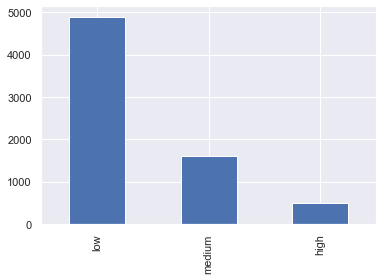

In [22]:
df["interest_level"].value_counts().plot(kind="bar")

In [23]:
def plot_ny_map_target(df):
    venues_map = folium.Map(location=[ny_latitude, ny_longitude], zoom_start=12)
    
    for lat, lng, label in zip(df.latitude, df.longitude, df.interest_level):
        if label == "low":
            color = 'blue'
        elif label == "medium":
            color = "green"
        else:
            color="red"
        folium.CircleMarker(
            [lat, lng],
            radius=3,
            color=color,
            popup=label
        ).add_to(venues_map)
    
    return venues_map

In [24]:
plot_ny_map_target(df)

### Renthop data features

Bathrooms:

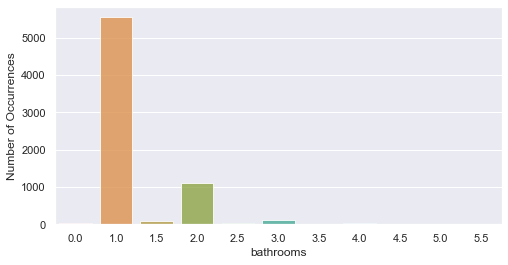

In [25]:
cnt_srs = df['bathrooms'].value_counts()

plt.figure(figsize=(8,4))
sns.barplot(x=cnt_srs.index, y=cnt_srs.values, alpha=0.8)
plt.ylabel('Number of Occurrences', fontsize=12)
plt.xlabel('bathrooms', fontsize=12)
plt.show()

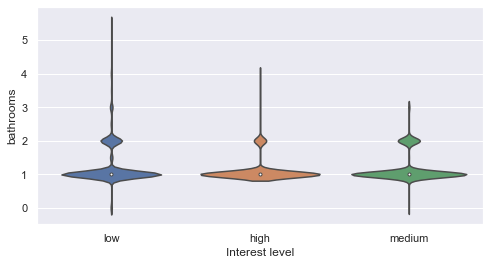

In [26]:
plt.figure(figsize=(8,4))
sns.violinplot(x='interest_level', y='bathrooms', data=df)
plt.xlabel('Interest level', fontsize=12)
plt.ylabel('bathrooms', fontsize=12)
plt.show()

Bedrooms:

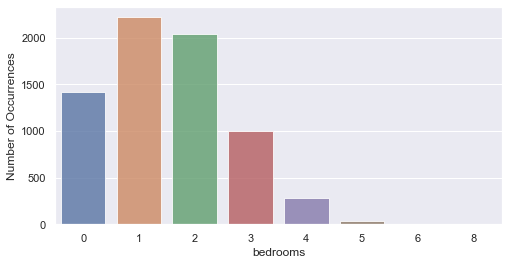

In [27]:
cnt_srs = df['bedrooms'].value_counts()

plt.figure(figsize=(8,4))
sns.barplot(x=cnt_srs.index, y=cnt_srs.values, alpha=0.8)
plt.ylabel('Number of Occurrences', fontsize=12)
plt.xlabel('bedrooms', fontsize=12)
plt.show()

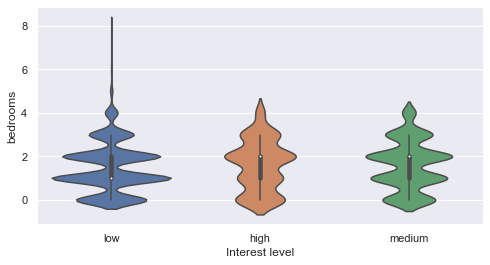

In [28]:
plt.figure(figsize=(8,4))
sns.violinplot(x='interest_level', y='bedrooms', data=df)
plt.xlabel('Interest level', fontsize=12)
plt.ylabel('bedrooms', fontsize=12)
plt.show()

Price:

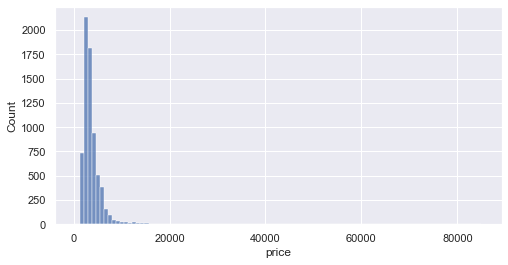

In [29]:
plt.figure(figsize=(8,4))
sns.histplot(df.price, bins=100)
plt.xlabel('price', fontsize=12)
plt.show()

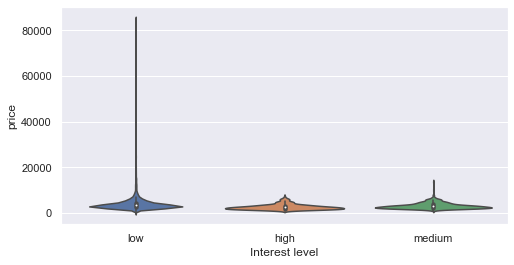

In [30]:
plt.figure(figsize=(8,4))
sns.violinplot(x='interest_level', y='price', data=df)
plt.xlabel('Interest level', fontsize=12)
plt.ylabel('price', fontsize=12)
plt.show()

Number of Photos:

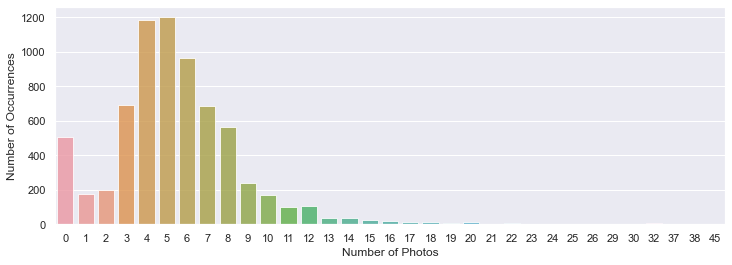

In [31]:
plt.figure(figsize=(12,4))
cnt_srs = df['num_photos'].value_counts()
sns.barplot(x=cnt_srs.index, y=cnt_srs.values, alpha=0.8)
plt.xlabel('Number of Photos', fontsize=12)
plt.ylabel('Number of Occurrences', fontsize=12)
plt.show()

Number of features:

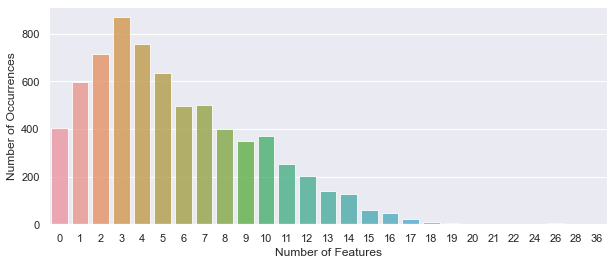

In [32]:
plt.figure(figsize=(10,4))
cnt_srs = df['num_features'].value_counts()
sns.barplot(x=cnt_srs.index, y=cnt_srs.values, alpha=0.8)
plt.xlabel('Number of Features', fontsize=12)
plt.ylabel('Number of Occurrences', fontsize=12)
plt.show()

### Foursquare data features

Geographical Visualisation of the additional feature mean_distance:

In [33]:
# Helper function for plotting map

def plot_ny_map_distance(df):
    venues_map = folium.Map(location=[ny_latitude, ny_longitude], zoom_start=12)
    colorlist = pd.cut(df["mean_distance"], bins=3, labels=[ 'green', 'yellow', 'red'])
    for index, row in df.iterrows():
        folium.CircleMarker(
            [row.latitude, row.longitude],
            radius=3,
            color=colorlist[index]
        ).add_to(venues_map)
    
    return venues_map

In [34]:
plot_ny_map_distance(df)

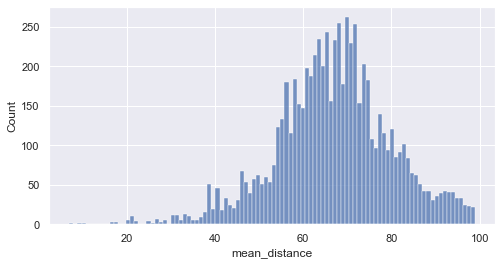

In [35]:
plt.figure(figsize=(8,4))
sns.histplot(df.mean_distance, bins=100)
plt.xlabel('mean_distance', fontsize=12)
plt.show()

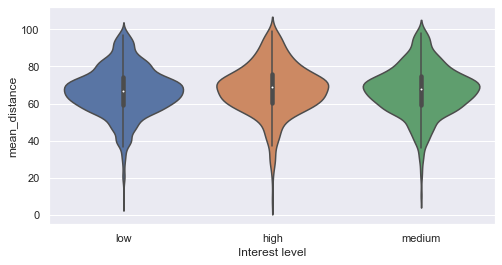

In [36]:
plt.figure(figsize=(8,4))
sns.violinplot(x='interest_level', y='mean_distance', data=df)
plt.xlabel('Interest level', fontsize=12)
plt.ylabel('mean_distance', fontsize=12)
plt.show()

In [37]:
# Helper function for plotting map

def plot_ny_map_categories(df):
    venues_map = folium.Map(location=[ny_latitude, ny_longitude], zoom_start=12)
    colorlist = pd.cut(df["categories"], bins=3, labels=[ 'green', 'yellow', 'red'])
    for index, row in df.iterrows():
        folium.CircleMarker(
            [row.latitude, row.longitude],
            radius=3,
            color=colorlist[index]
        ).add_to(venues_map)
    
    return venues_map

In [38]:
pd.cut(df["categories"], bins=3, labels=[ 'green', 'yellow', 'red'])

0        green
1        green
2        green
3        green
4       yellow
         ...  
6980     green
6981    yellow
6982     green
6983     green
6984    yellow
Name: categories, Length: 6985, dtype: category
Categories (3, object): ['green' < 'yellow' < 'red']

In [39]:
plot_ny_map_categories(df)

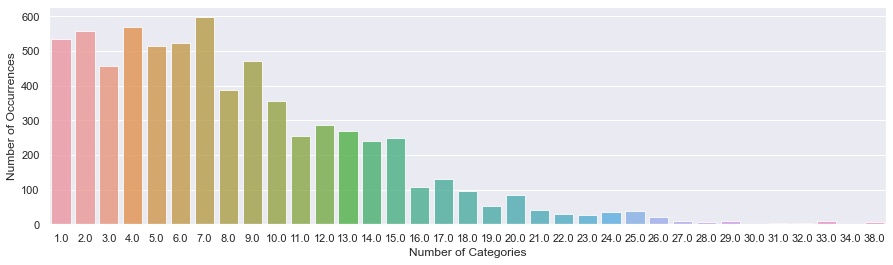

In [40]:
plt.figure(figsize=(15,4))
cnt_srs = df['categories'].value_counts()
sns.barplot(x=cnt_srs.index, y=cnt_srs.values, alpha=0.8)
plt.xlabel('Number of Categories', fontsize=12)
plt.ylabel('Number of Occurrences', fontsize=12)
plt.show()

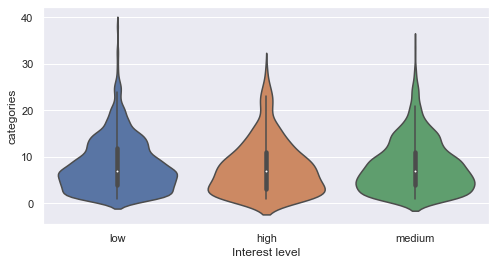

In [41]:
plt.figure(figsize=(8,4))
sns.violinplot(x='interest_level', y='categories', data=df)
plt.xlabel('Interest level', fontsize=12)
plt.ylabel('categories', fontsize=12)
plt.show()

Map interest level to number:

In [42]:
df["interest_level"] = df["interest_level"].map({"low": 1, "medium": 2, "high": 3})

### Correlation with target variable

In [43]:
df_corr = df.corr()
mask = np.zeros_like(df_corr)
mask[np.triu_indices_from(mask)] = True
df_corr_masked = df_corr.where(mask==0)

In [44]:
fig = px.imshow(df_corr_masked, color_continuous_scale='Spectral', aspect='equal', width=500, height=500, title="Pairwise Correlation Pearson", range_color=[-1,1])
fig.show()

Unfortunately, the newly created features "categories" and "mean_distance" have very low correlation values with the target variable (-0.03 and 0.02 respectively). Maybe the model can identify more complex patterns.

### Algorithms

For the modelling process of this project, we will use the h2o.ai framework. H2O is a Java-based software for data modeling and general computing. The H2O software is many things, but the primary purpose of H2O is as a distributed (many machines), parallel (many CPUs), in memory (several hundred GBs Xmx) processing engine. (http://docs.h2o.ai/h2o/latest-stable/h2o-py/docs/intro.html) 


In particular the H2OGradientBoostingEstimator will be used to train a baseline model and compare it to an advanced model with the newly created features. Gradient boosting is a machine learning technique for regression and classification problems, which produces a prediction model in the form of an ensemble of weak prediction models, typically decision trees. When a decision tree is the weak learner, the resulting algorithm is called gradient boosted trees, which usually outperforms random forest. It builds the model in a stage-wise fashion like other boosting methods do, and it generalizes them by allowing optimization of an arbitrary differentiable loss function.


# 4. Results

In the following we will build two models:
* Baseline Model with standard features
* Extended Model with additional features (2 new foursquare api features; categories + mean_distance)

In [45]:
df.columns.to_list()

['bathrooms',
 'bedrooms',
 'latitude',
 'longitude',
 'price',
 'interest_level',
 'categories',
 'mean_distance',
 'num_photos',
 'num_features',
 'num_description_words',
 'created_month',
 'created_day',
 'created_hour']

In [46]:
target = "interest_level"

## 4.1 Baseline Model

In [47]:
features_base = ['bathrooms',
 'bedrooms',
 'latitude',
 'longitude',
 'price',
 'interest_level',
 'num_photos',
 'num_features',
 'num_description_words',
 'created_month',
 'created_day',
 'created_hour']

In [48]:
hf_base = h2o.H2OFrame(df[features_base])

Parse progress: |█████████████████████████████████████████████████████████| 100%


In [49]:
hf_base.describe()

Rows:6985
Cols:12




,bathrooms,bedrooms,latitude,longitude,price,interest_level,num_photos,num_features,num_description_words,created_month,created_day,created_hour
type,real,int,real,real,int,int,int,int,int,int,int,int
mins,0.0,0.0,40.045,-75.5214,401.0,1.0,0.0,0.0,1.0,4.0,1.0,0.0
mean,1.2161775232641423,1.5166785969935594,40.75152962061557,-73.97427738010023,3711.015175375806,1.3700787401574837,5.489191123836783,5.575232641374394,91.82534001431655,4.799427344309208,15.319255547602028,4.512956335003559
maxs,5.5,8.0,41.0868,-73.7001,85000.0,3.0,45.0,36.0,629.0,6.0,31.0,23.0
sigma,0.4983609934788079,1.119077700727222,0.0377936746237496,0.0330370847242233,2352.7197209599676,0.6122960254481706,3.5354009448779276,3.981391337543777,60.389456385671465,0.6004482037973504,8.099644860633813,4.032248964093249
zeros,44,1414,0,0,0,0,508,403,0,0,0,10
missing,0,0,0,0,0,0,0,0,0,0,0,0
0,1.0,0.0,40.746,-73.9754,2195.0,1.0,4.0,5.0,15.0,6.0,24.0,2.0
1,2.0,2.0,40.7456,-74.0053,5975.0,1.0,6.0,4.0,55.0,6.0,10.0,2.0
2,1.0,1.0,40.7685,-73.9895,4960.0,1.0,7.0,10.0,118.0,6.0,14.0,2.0


In [50]:
predictors_base = features_base.copy()
predictors_base.remove(target)

In [51]:
train, valid = hf_base.split_frame()

In [52]:
model_base = H2OXGBoostEstimator()
model_base.train(x=predictors_base,y=target,training_frame=train, validation_frame=valid)

xgboost Model Build progress: |███████████████████████████████████████████| 100%


In [53]:
model_base

Model Details
H2OXGBoostEstimator :  XGBoost
Model Key:  XGBoost_model_python_1615900664988_18


Model Summary: 


,,number_of_trees
0,,50.0




ModelMetricsRegression: xgboost
** Reported on train data. **

MSE: 0.10310223547940588
RMSE: 0.32109536819986345
MAE: 0.22951412182727843
RMSLE: 0.12185293568789049
Mean Residual Deviance: 0.10310223547940588

ModelMetricsRegression: xgboost
** Reported on validation data. **

MSE: 0.3089856275361791
RMSE: 0.5558647565156286
MAE: 0.4127542941139899
RMSLE: 0.20822033448262603
Mean Residual Deviance: 0.3089856275361791

Scoring History: 


,,timestamp,duration,number_of_trees,training_rmse,training_mae,training_deviance,validation_rmse,validation_mae,validation_deviance
0,,2021-03-19 19:38:15,0.025 sec,0.0,1.059310,0.866031,1.122137,1.077578,0.882235,1.161175
1,,2021-03-19 19:38:15,0.151 sec,1.0,0.832399,0.608929,0.692888,0.856724,0.625758,0.733976
2,,2021-03-19 19:38:16,0.182 sec,2.0,0.691105,0.446194,0.477626,0.725989,0.471825,0.527060
3,,2021-03-19 19:38:16,0.210 sec,3.0,0.601552,0.379040,0.361865,0.645303,0.411168,0.416416
4,,2021-03-19 19:38:16,0.241 sec,4.0,0.549703,0.353854,0.302173,0.599675,0.388838,0.359610
5,,2021-03-19 19:38:16,0.268 sec,5.0,0.518823,0.346101,0.269178,0.573602,0.384813,0.329020
6,,2021-03-19 19:38:16,0.280 sec,6.0,0.497893,0.344324,0.247897,0.562716,0.390398,0.316649
7,,2021-03-19 19:38:16,0.296 sec,7.0,0.480667,0.340551,0.231041,0.551061,0.390035,0.303668
8,,2021-03-19 19:38:16,0.316 sec,8.0,0.471794,0.340822,0.222589,0.545965,0.393039,0.298077
9,,2021-03-19 19:38:16,0.349 sec,9.0,0.459855,0.334966,0.211467,0.542105,0.393307,0.293877



See the whole table with table.as_data_frame()

Variable Importances: 


,variable,relative_importance,scaled_importance,percentage
0,price,701.211609,1.000000,0.263878
1,latitude,351.877838,0.501814,0.132418
2,longitude,300.367859,0.428356,0.113034
3,created_hour,283.375549,0.404123,0.106639
4,num_description_words,279.596497,0.398733,0.105217
5,bedrooms,253.864975,0.362038,0.095534
6,num_features,164.576920,0.234704,0.061933
7,num_photos,148.503006,0.211781,0.055884
8,created_day,121.143990,0.172764,0.045589
9,created_month,32.035213,0.045686,0.012055


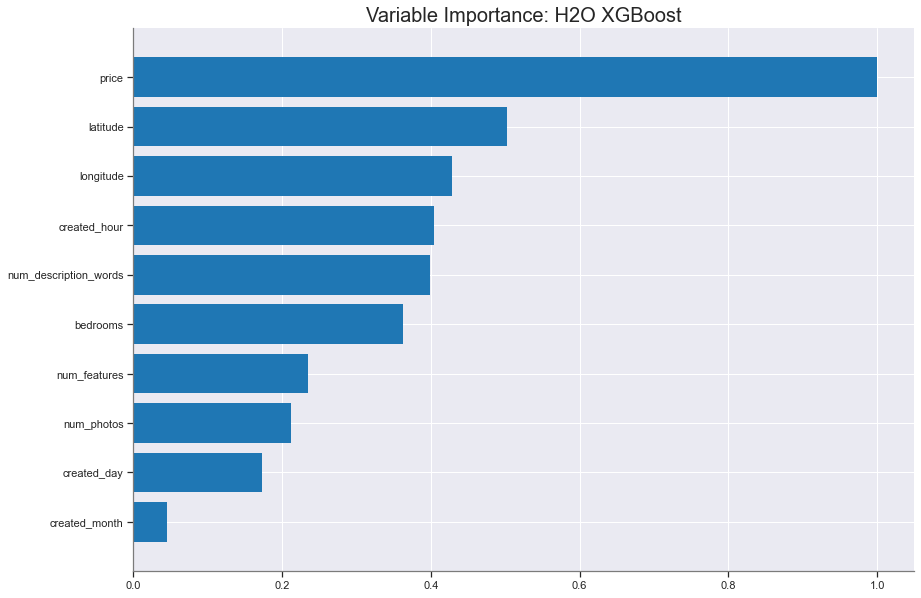

In [54]:
model_base.varimp_plot()

## 4.2 Extended Model

In [57]:
features_extended = ['bathrooms',
 'bedrooms',
 'latitude',
 'longitude',
 'price',
 'interest_level',
 'categories',
 'mean_distance',
 'num_photos',
 'num_features',
 'num_description_words',
 'created_month',
 'created_day',
 'created_hour']

In [58]:
hf_extended = h2o.H2OFrame(df[features_extended])

Parse progress: |█████████████████████████████████████████████████████████| 100%


In [59]:
hf_extended.describe()

Rows:6985
Cols:14




,bathrooms,bedrooms,latitude,longitude,price,interest_level,categories,mean_distance,num_photos,num_features,num_description_words,created_month,created_day,created_hour
type,real,int,real,real,int,int,int,real,int,int,int,int,int,int
mins,0.0,0.0,40.045,-75.5214,401.0,1.0,1.0,7.0,0.0,0.0,1.0,4.0,1.0,0.0
mean,1.2161775232641423,1.5166785969935594,40.75152962061557,-73.97427738010023,3711.015175375806,1.3700787401574837,8.201431639226913,66.9059290175748,5.489191123836783,5.575232641374394,91.82534001431655,4.799427344309208,15.319255547602028,4.512956335003559
maxs,5.5,8.0,41.0868,-73.7001,85000.0,3.0,38.0,99.0,45.0,36.0,629.0,6.0,31.0,23.0
sigma,0.4983609934788079,1.119077700727222,0.0377936746237496,0.0330370847242233,2352.7197209599676,0.6122960254481706,5.705742390951643,13.218887504139555,3.5354009448779276,3.981391337543777,60.389456385671465,0.6004482037973504,8.099644860633813,4.032248964093249
zeros,44,1414,0,0,0,0,0,0,508,403,0,0,0,10
missing,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,1.0,0.0,40.746,-73.9754,2195.0,1.0,7.0,62.85714285714285,4.0,5.0,15.0,6.0,24.0,2.0
1,2.0,2.0,40.7456,-74.0053,5975.0,1.0,5.0,61.333333333333336,6.0,4.0,55.0,6.0,10.0,2.0
2,1.0,1.0,40.7685,-73.9895,4960.0,1.0,5.0,69.4,7.0,10.0,118.0,6.0,14.0,2.0


In [60]:
predictors_extended = features_extended.copy()
predictors_extended.remove(target)

In [61]:
train, valid = hf_extended.split_frame(ratios=[.8], seed=1337)

In [62]:
model_extended = H2OXGBoostEstimator()
model_extended.train(x=predictors_extended,y=target,training_frame=train, validation_frame=valid)

xgboost Model Build progress: |███████████████████████████████████████████| 100%


In [63]:
model_extended

Model Details
H2OXGBoostEstimator :  XGBoost
Model Key:  XGBoost_model_python_1615900664988_19


Model Summary: 


,,number_of_trees
0,,50.0




ModelMetricsRegression: xgboost
** Reported on train data. **

MSE: 0.10576568267200558
RMSE: 0.325216362860182
MAE: 0.2385363140620554
RMSLE: 0.12360921399249745
Mean Residual Deviance: 0.10576568267200558

ModelMetricsRegression: xgboost
** Reported on validation data. **

MSE: 0.28407932501548677
RMSE: 0.5329909239522628
MAE: 0.39601573324063966
RMSLE: 0.20110877803600802
Mean Residual Deviance: 0.28407932501548677

Scoring History: 


,,timestamp,duration,number_of_trees,training_rmse,training_mae,training_deviance,validation_rmse,validation_mae,validation_deviance
0,,2021-03-19 19:38:58,0.009 sec,0.0,1.065537,0.870773,1.135368,1.057163,0.867228,1.117593
1,,2021-03-19 19:38:58,0.036 sec,1.0,0.838369,0.612252,0.702863,0.837603,0.609691,0.701578
2,,2021-03-19 19:38:58,0.049 sec,2.0,0.693596,0.449201,0.481075,0.705293,0.454879,0.497438
3,,2021-03-19 19:38:58,0.063 sec,3.0,0.605946,0.378431,0.367171,0.628300,0.393549,0.394761
4,,2021-03-19 19:38:58,0.075 sec,4.0,0.549441,0.354881,0.301885,0.582904,0.378740,0.339778
5,,2021-03-19 19:38:58,0.088 sec,5.0,0.515095,0.346981,0.265323,0.557970,0.378863,0.311331
6,,2021-03-19 19:38:58,0.100 sec,6.0,0.495011,0.345361,0.245035,0.544173,0.382996,0.296125
7,,2021-03-19 19:38:58,0.111 sec,7.0,0.478391,0.341480,0.228858,0.536661,0.385470,0.288005
8,,2021-03-19 19:38:58,0.123 sec,8.0,0.467468,0.340038,0.218526,0.533982,0.390113,0.285136
9,,2021-03-19 19:38:58,0.134 sec,9.0,0.457828,0.336314,0.209607,0.531029,0.391499,0.281992



See the whole table with table.as_data_frame()

Variable Importances: 


,variable,relative_importance,scaled_importance,percentage
0,price,714.531799,1.000000,0.249046
1,latitude,298.299255,0.417475,0.103970
2,created_hour,282.722412,0.395675,0.098541
3,longitude,282.630615,0.395547,0.098509
4,num_description_words,265.266693,0.371245,0.092457
5,bedrooms,230.007828,0.321900,0.080168
6,num_features,174.626999,0.244394,0.060865
7,num_photos,174.147125,0.243722,0.060698
8,mean_distance,167.568039,0.234514,0.058405
9,created_day,127.414162,0.178318,0.044409


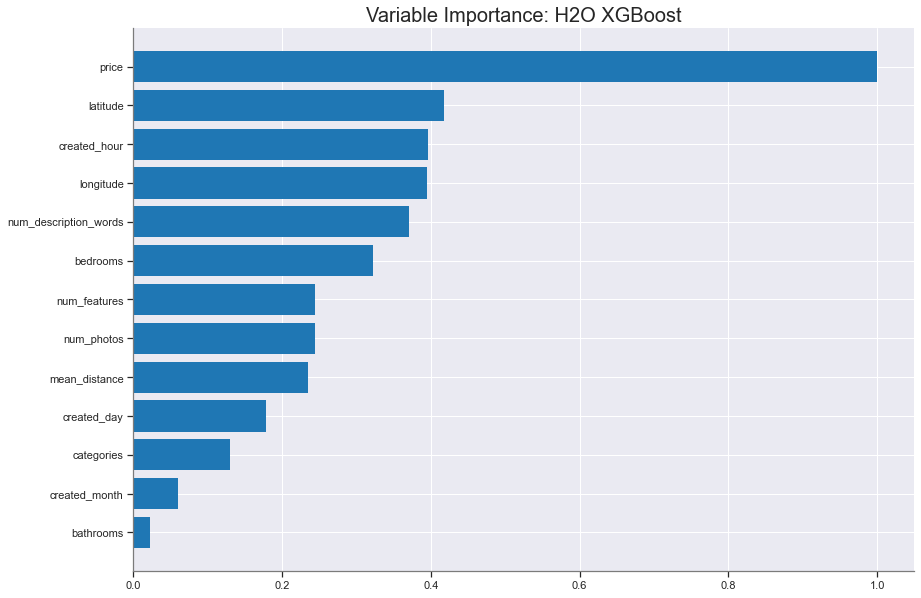

In [64]:
model_extended.varimp_plot(num_of_features=13)

## 4.3 Tuning/AutoML

In [169]:
aml = H2OAutoML(max_models=25, seed=1)
aml.train(x=predictors_extended,y=target,training_frame=train, validation_frame=valid)


11:49:50.422: User specified a validation frame with cross-validation still enabled. Please note that the models will still be validated using cross-validation only, the validation frame will be used to provide purely informative validation metrics on the trained models.

Failed polling AutoML progress log: Unexpected HTTP error: ('Connection aborted.', BadStatusLine('POST /99/Rapids HTTP/1.1\r\n'))


In [85]:

get_aml = h2o.automl.get_automl(aml.project_name)

In [86]:
lb = h2o.automl.get_leaderboard(aml, extra_columns = 'ALL')

In [87]:
lb

model_id,mean_per_class_error,logloss,rmse,mse,auc,aucpr,training_time_ms,predict_time_per_row_ms
XGBoost_grid__1_AutoML_20210318_234146_model_2,0.562112,0.7174,0.481858,0.232187,nan,nan,1910,0.02715
XGBoost_1_AutoML_20210318_234146,0.56224,0.681295,0.474935,0.225563,nan,nan,1127,0.017917
XGBoost_grid__1_AutoML_20210318_234146_model_4,0.562361,0.643762,0.465832,0.217,nan,nan,1196,0.016551
XGBoost_grid__1_AutoML_20210318_234146_model_1,0.564214,0.652901,0.469278,0.220222,nan,nan,2541,0.013226
GBM_3_AutoML_20210318_234146,0.5667,0.66458,0.469288,0.220231,nan,nan,574,0.070734
XGBoost_grid__1_AutoML_20210318_234146_model_3,0.566739,0.645664,0.467498,0.218554,nan,nan,900,0.012717
XGBoost_2_AutoML_20210318_234146,0.570452,0.699285,0.477725,0.228222,nan,nan,1900,0.020559
XGBoost_3_AutoML_20210318_234146,0.572791,0.653383,0.469156,0.220107,nan,nan,1086,0.012373
GBM_4_AutoML_20210318_234146,0.575974,0.659604,0.469623,0.220546,nan,nan,539,0.065661
GBM_5_AutoML_20210318_234146,0.577852,0.639809,0.466915,0.21801,nan,nan,712,0.07237


In this case a negative Result is also a valuable lesson 

# 5. Discussion

In this section, we will discuss the obtained results from the modelling process. For the baseline model, we achieved a root mean squared error (RMSE) of 0.305 on the training set and 0.463 on the validation set. This results in an error rate for the classes of 8% on the training data and 29% on the validation data. For the extended model with 2 additional features the results are quite comparable with a RMSE of 0.298 on the training set and 0.463 on the validation set. The error rate for the training data is around 7% and 28% for the testing data. In total we could achieve a slight improvement by adding the additional features to our modelling process, but it was not as significant as expected. By locking at the plots for the variable importance of both new features, one can see that the importance of “mean_distance” lies within the top 7 features. The “category” feature was not so important after all, which was quite surprising.

# 6. Conclusion


The Purpose of this project was to identify new features for rental listings that can be used to predict the interest level of a customer. For this reason, two features have been proposed. Unfortunately, the importance for the model to predict the interest level of a customer was not significant and thus not really adding any new business value to the model. Nonetheless it was an interesting exercise and in a real-world case it is also quite helpful to reject a hypothesis and not invest in it. In addition, we have been quite limited by the free version of the foursquare api which only allows a specific quota for calls in a defined time period. For this reason, only a small subset of the dataset could be added to the competition data. It would be interesting to test more features with higher rate limits in the future.